In [1]:
# Data Manipulation
import pandas as pd
import numpy as np

# Data Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Display settings for better visualization
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_colwidth', None)

# Set styles for plots
plt.style.use('fivethirtyeight')
plt.style.use('bmh')


In [2]:
# Load dataset
df = pd.read_csv('train.csv')

# Display first 10 rows
df.head(10)


,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,NaN,NaN,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,6.0,14.0,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,NaN,NaN,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,14.0,NaN,1057
4,1000002,P00285442,M,55+,16,C,4+,0,8,NaN,NaN,7969
5,1000003,P00193542,M,26-35,15,A,3,0,1,2.0,NaN,15227
6,1000004,P00184942,M,46-50,7,B,2,1,1,8.0,17.0,19215
7,1000004,P00346142,M,46-50,7,B,2,1,1,15.0,NaN,15854
8,1000004,P0097242,M,46-50,7,B,2,1,1,16.0,NaN,15686
9,1000005,P00274942,M,26-35,20,A,1,1,8,NaN,NaN,7871


In [3]:
# Check missing values
df.isnull().sum()


User_ID                            0
Product_ID                         0
Gender                             0
Age                                0
Occupation                         0
City_Category                      0
Stay_In_Current_City_Years         0
Marital_Status                     0
Product_Category_1                 0
Product_Category_2            173638
Product_Category_3            383247
Purchase                           0
dtype: int64

In [4]:
# Filling missing values in Product_Category_2 using mode for each Age group
product2_mode = df.groupby('Age')['Product_Category_2'].agg(pd.Series.mode)
for age_group in product2_mode.index:
    df.loc[(df['Age'] == age_group) & (df['Product_Category_2'].isnull()), 'Product_Category_2'] = product2_mode[age_group]

# Filling missing values in Product_Category_3 similarly
product3_mode = df.groupby('Age')['Product_Category_3'].agg(pd.Series.mode)
for age_group in product3_mode.index:
    df.loc[(df['Age'] == age_group) & (df['Product_Category_3'].isnull()), 'Product_Category_3'] = product3_mode[age_group]

# Verify missing values are handled
df.isnull().sum()


User_ID                       0
Product_ID                    0
Gender                        0
Age                           0
Occupation                    0
City_Category                 0
Stay_In_Current_City_Years    0
Marital_Status                0
Product_Category_1            0
Product_Category_2            0
Product_Category_3            0
Purchase                      0
dtype: int64

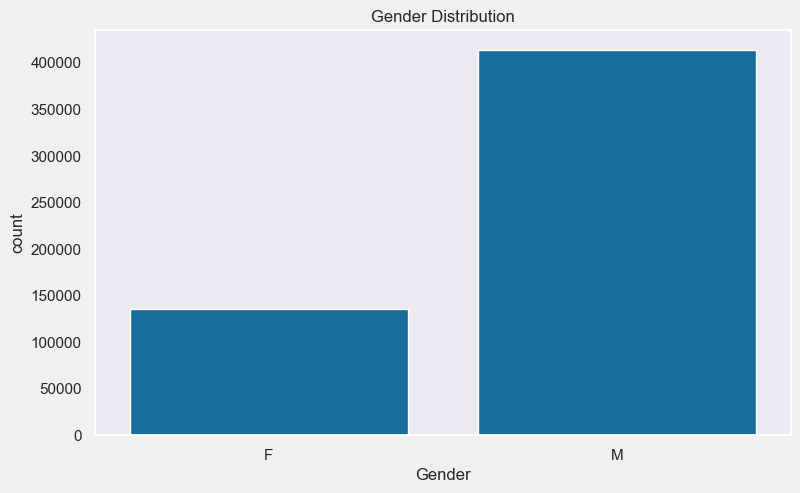

In [5]:
plt.figure(figsize=(8,5))
sns.set(style='dark', palette='colorblind')
sns.countplot(x='Gender', data=df)
plt.title('Gender Distribution')
plt.show()


C:\Users\shivh\AppData\Local\Temp\ipykernel_16568\3002221926.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Age', data=df, palette='viridis')


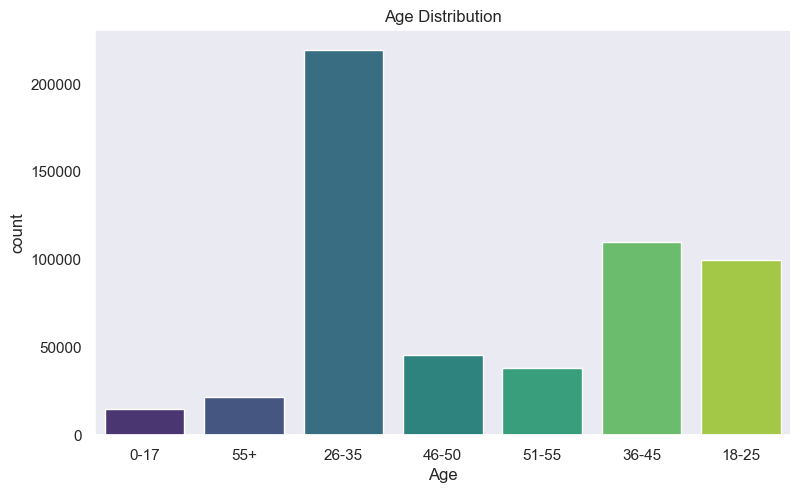

In [6]:
plt.figure(figsize=(8,5))
sns.countplot(x='Age', data=df, palette='viridis')
plt.title('Age Distribution')
plt.show()


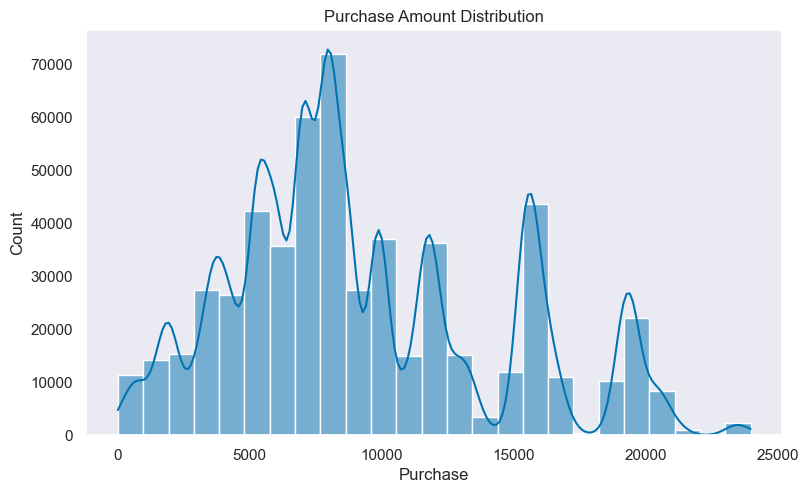

In [7]:
plt.figure(figsize=(8,5))
sns.histplot(df['Purchase'], bins=25, kde=True)
plt.title('Purchase Amount Distribution')
plt.show()


C:\Users\shivh\AppData\Local\Temp\ipykernel_16568\3410299221.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Gender', y='Purchase', data=df, palette='coolwarm')


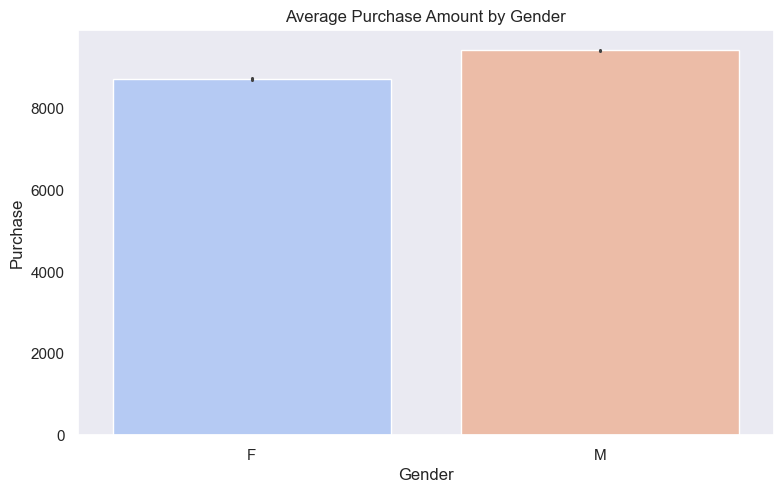

In [8]:
plt.figure(figsize=(8,5))
sns.barplot(x='Gender', y='Purchase', data=df, palette='coolwarm')
plt.title('Average Purchase Amount by Gender')
plt.show()


C:\Users\shivh\AppData\Local\Temp\ipykernel_16568\23565483.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Age', y='Purchase', data=df, palette='pastel')


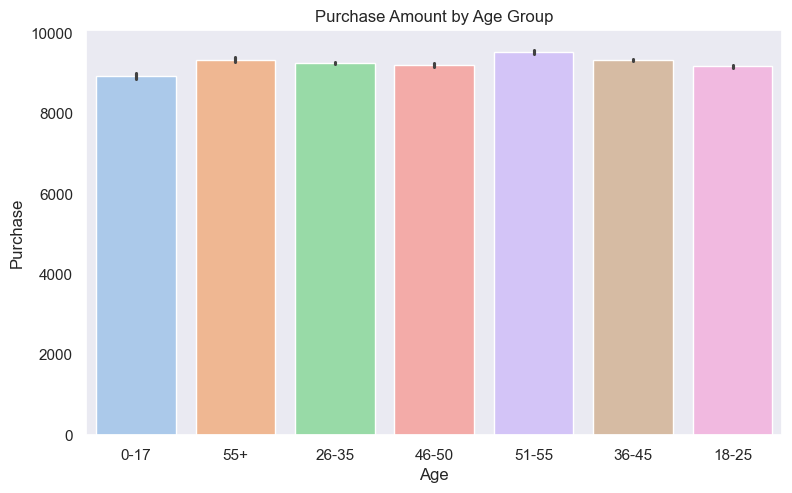

In [9]:
plt.figure(figsize=(8,5))
sns.barplot(x='Age', y='Purchase', data=df, palette='pastel')
plt.title('Purchase Amount by Age Group')
plt.show()


In [10]:
fig = px.histogram(df, x='Product_Category_1', color='City_Category', title="Product 1 Purchase by City")
fig.show()

fig = px.histogram(df, x='Product_Category_2', color='City_Category', title="Product 2 Purchase by City")
fig.show()

fig = px.histogram(df, x='Product_Category_3', color='City_Category', title="Product 3 Purchase by City")
fig.show()
